# Welcome to my data visualization project

> In this project, I will utilize **Seaborn** and **Plotly** libraries to visualize the insights extracted from a Brazilian ecommerce public dataset of orders made at Olist Store. The dataset has information of 100k orders from 2016 to 2018 made at multiple marketplaces in Brazil. Its 21 supportive features allows viewing an order from multiple dimensions: from order status, price and freight performance to customer location, and product attribute.

We will be using 4 datasets.

This dataset includes random latitudes and longitudes from a given zip code prefix.<br>

geolocation_olist_public_dataset.csv<br>

-  zip_code_prefix: The first three digits of a zip code.
-  city: City associated with the zip code.
-  state: State/province associated with zip code.
-  lat: latitude of a random address with a given zip code_prefix.
-  lng: longitude of a random address with a given zip code_prefix.

This dataset includes 100k rows and 21 features.<br>

olist_public_dataset_v2.csv<br>

-  order_id: unique identifier of the order.
-  order_status: Reference to the order status (delivered, shipped, etc).
-  order_products_value: Total products price of an order.
-  order_freight_value: Total freight value of an order.
-  order_items_qty: Total quantity of items purchased in an order.
-  order_sellers_qty: Total quantity of sellers that fulfilled an order.
-  order_purchase_timestamp: Shows the purchase timestamp.
-  order_aproved_at: Shows the payment approval timestamp.
-  order_estimated_delivery_date: Shows the estimated delivery date that was informed to customer at the purchase moment.
-  order_delivered_customer_date: Shows the actual order delivery date to the customer.
-  customer_id: identifier of customer. Each order always have an unique customer. To find the unique customers_id see the customers dataset.
-  customer_city: Customer city
-  customer_state: Customer state/province
-  customer_zip_code_prefix: The first three digits of customer zip code.
-  product_category_name: The root category of the purchased product, in Portuguese.
-  product_name_lenght: Number of characters extracted from the purchased product name.
-  product_description_lenght: Number of characters extracted from the purchased product description.
-  product_photos_qty: Number of purchased product published photos.
-  product_id: unique identifier of product.
-  review_id: unique identifier of review
-  review_score: Note ranging from 1 to 5 given by the customer on a satisfaction survey.
-  review_comment_title: Comment title from the review left by the customer, in Portuguese.
-  review_comment_message: Comment message from the review left by the customer, in Portuguese.
-  review_creation_date: Shows the date in which the satisfaction survey was sent to the customer.
-  review_answer_timestamp: Shows satisfaction survey answer timestamp.

This dataset includes data about the payment options from orders.<br>

payments_olist_public_dataset.csv<br>

-  order_id: unique identifier of an order.
-  installments: quantity of installments chosen by the customer.
-  sequential: a customer may pay an order with more than one payment method. If he does so, a sequence will be created to accommodate all payments.
-  payment_type: method of payment chosen by the customer.
-  value: transaction value.

This dataset contains the english translation of product_category_name<br><br>
product_category_name_translation.csv

<br>
Let's start by importing the necessary libraries.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import init_notebook_mode, iplot
import plotly.plotly as py
import plotly.graph_objs as go
from plotly import tools
import datetime
import warnings
warnings.simplefilter(action = 'ignore', category = FutureWarning)
init_notebook_mode(connected = True)

<br>
Let's import the datasets.

In [2]:
geo = pd.read_csv("C:/Users/Richard Cheung/Desktop/Personal Projects/Personal Project IV/brazilian-ecommerce/geolocation_olist_public_dataset.csv")
customer = pd.read_csv("C:/Users/Richard Cheung/Desktop/Personal Projects/Personal Project IV/brazilian-ecommerce/olist_public_dataset_v2.csv")
payment = pd.read_csv("C:/Users/Richard Cheung/Desktop/Personal Projects/Personal Project IV/brazilian-ecommerce/payments_olist_public_dataset.csv")
translation = pd.read_csv("C:/Users/Richard Cheung/Desktop/Personal Projects/Personal Project IV/brazilian-ecommerce/product_category_name_translation.csv")

<br>
Let's have a glimpse of our main dataset, customer.

In [3]:
print(customer.shape)
customer.head()

(100000, 25)


,order_id,order_status,order_products_value,order_freight_value,order_items_qty,order_sellers_qty,order_purchase_timestamp,order_aproved_at,order_estimated_delivery_date,order_delivered_customer_date,...,product_name_lenght,product_description_lenght,product_photos_qty,product_id,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,b95df3cef5297e79ef709ba256518f6f,delivered,349.90,13.84,1,1,2017-01-31 17:19:01.000000,2017-02-01 02:41:21.549551,2017-03-15 00:00:00.000000,2017-02-06 11:04:24.154259,...,51,625,1,6cdd53843498f92890544667809f1595,b95df3cef5297e79ef709ba256518f6f,5,NaN,NaN,2017-02-07 00:00:00.000000,2017-02-09 02:37:37+00:00
1,59af46052a799e80e2f0c665c587731d,delivered,15.00,15.10,1,1,2017-09-09 19:52:54.000000,2017-09-10 20:03:31.535281,2017-10-02 00:00:00.000000,2017-09-13 20:17:41.296915,...,44,1428,2,ae5cad88462eb7b7b61401e31c45618e,59af46052a799e80e2f0c665c587731d,5,NaN,entrega em 2 dias produto c boa qualidade otim...,2017-09-14 00:00:00.000000,2017-09-15 03:43:47+00:00
2,a3e6136894621db402a772c6bc72a12a,delivered,238.90,18.00,1,1,2017-01-30 17:00:09.000000,2017-01-30 17:31:25.438253,2017-03-07 00:00:00.000000,2017-02-06 15:43:04.758566,...,55,637,1,0c9ff9d8ed9b9bdd825487b3a66e05f5,a3e6136894621db402a772c6bc72a12a,5,NaN,produto veio antes do prazo informado muito ob...,2017-02-07 00:00:00.000000,2017-02-10 14:18:53+00:00
3,b675ea5a618922f6e679e30531b8957b,delivered,29.99,18.23,1,1,2018-03-11 18:18:36.000000,2018-03-11 18:30:37.931962,2018-04-03 00:00:00.000000,2018-04-03 20:36:43.778451,...,55,617,1,ad0a798e7941f3a5a2fb8139cb62ad78,b675ea5a618922f6e679e30531b8957b,4,NaN,NaN,2018-04-04 00:00:00.000000,2018-04-05 02:52:31+00:00
4,195a8be6794c487fe6cfbb97b7c61902,delivered,295.99,47.65,1,1,2017-04-20 08:01:08.000000,2017-04-25 08:05:40.405383,2017-05-24 00:00:00.000000,2017-05-04 18:47:45.721758,...,49,558,2,eaf2046d4c87809247a30050ea13df03,195a8be6794c487fe6cfbb97b7c61902,5,NaN,NaN,2017-05-05 00:00:00.000000,2017-05-08 15:20:18+00:00


In [4]:
customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 25 columns):
order_id                         100000 non-null object
order_status                     100000 non-null object
order_products_value             100000 non-null float64
order_freight_value              100000 non-null float64
order_items_qty                  100000 non-null int64
order_sellers_qty                100000 non-null int64
order_purchase_timestamp         100000 non-null object
order_aproved_at                 99982 non-null object
order_estimated_delivery_date    100000 non-null object
order_delivered_customer_date    97595 non-null object
customer_id                      100000 non-null object
customer_city                    100000 non-null object
customer_state                   100000 non-null object
customer_zip_code_prefix         100000 non-null int64
product_category_name            100000 non-null object
product_name_lenght              100000 non-null int6

In [5]:
customer.describe()

,order_products_value,order_freight_value,order_items_qty,order_sellers_qty,customer_zip_code_prefix,product_name_lenght,product_description_lenght,product_photos_qty,review_score
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.0000,100000.000000
mean,129.191704,21.739202,1.100090,1.141690,353.768400,48.839630,779.020710,2.2781,4.054110
std,194.863060,20.088368,0.459189,0.708829,297.682699,10.139335,665.387848,1.7495,1.363591
min,2.000000,0.000000,1.000000,1.000000,10.000000,5.000000,8.000000,1.0000,1.000000
25%,46.990000,13.470000,1.000000,1.000000,116.000000,42.000000,340.000000,1.0000,4.000000
50%,83.650000,16.790000,1.000000,1.000000,250.000000,52.000000,591.000000,2.0000,5.000000
75%,145.900000,23.010000,1.000000,1.000000,590.000000,57.000000,978.000000,3.0000,5.000000
max,13440.000000,1562.100000,20.000000,30.000000,999.000000,72.000000,3992.000000,20.0000,5.000000


In [6]:
customer.select_dtypes('object').apply(pd.Series.nunique, axis = 0)

order_id                         96264
order_status                         7
order_purchase_timestamp         95706
order_aproved_at                 96239
order_estimated_delivery_date      480
order_delivered_customer_date    93915
customer_id                      96264
customer_city                     4121
customer_state                      27
product_category_name               71
product_id                       24447
review_id                        96264
review_comment_title              3365
review_comment_message           33782
review_creation_date               668
review_answer_timestamp          95884
dtype: int64

In [7]:
# Use a function to determine missing values in our table
def missing_value_table(df):
    
    mis_val = df.isnull().sum()
    
    mis_val_percentage = 100 * mis_val / len(df)
    
    mis_val_table = pd.concat([mis_val, mis_val_percentage], axis = 1)
    
    mis_val_table = mis_val_table.rename(columns = {0: 'Missing Values', 
                                                    1: '% of Total Missing Values'})
    
    mis_val_table = mis_val_table[
        mis_val_table.iloc[:, 1] != 0].sort_values(
        '% of Total Missing Values', ascending = False).round(1)
    
    print("The dataframe has " + str(df.shape[0]) + " columns.\n"
         "There are  " + str(mis_val_table.shape[0]) + 
         " columns that have missing values.")
    
    return mis_val_table

In [8]:
missing_value_table(customer)

The dataframe has 100000 columns.
There are  4 columns that have missing values.


,Missing Values,% of Total Missing Values
review_comment_title,91738,91.7
review_comment_message,57511,57.5
order_delivered_customer_date,2405,2.4
order_aproved_at,18,0.0


We can ignore the review_comment_title and review_comment_message columns as we will not be using them in this project. However, we will be looking at order_delivered_customer_date and order_aprove_at columns, so we might have to drop the rows with missing value as they will affect the accuracy of our data visualization.

<br>
The product_category_name in the customer table are in Portuguese. Therefore, we will replace them with their english names using the translation table.

In [9]:
for i in range(0,len(translation)):
    customer.product_category_name[customer.product_category_name==translation.iloc[i,0]] = translation.iloc[i,1]
customer.product_category_name.head()

C:\Users\Richard Cheung\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



0            health_beauty
1    computers_accessories
2                     auto
3           bed_bath_table
4          furniture_decor
Name: product_category_name, dtype: object

In [10]:
df = customer.groupby('product_category_name')['review_score'].agg(['mean']).reset_index().sort_values(by = 'mean', ascending = False)

data = [go.Bar(
            y = df['product_category_name'].head(10),
            x = df['mean'],
            orientation = 'h',
            text = df['mean'],
            textposition = 'auto',
            name = '',
            marker = dict(
                color='rgba(50, 171, 96, 0.6)',
                line=dict(
                    color='rgba(50, 171, 96, 1.0)',
                    width=1))
    )]

layout = go.Layout(
    title='Top 10 Average Review by Categories',
    xaxis=dict(
        title='Average Review',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
     yaxis=dict(
        title='Product Category',
        automargin = True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig, filename='review_score')

In [11]:
df = customer.loc[customer['review_score'] == 5].groupby('product_category_name')['review_score'].agg(['count']).reset_index().sort_values(by = 'count', ascending = False)

data = [go.Bar(
            y = df['product_category_name'].head(10),
            x = df['count'],
            orientation = 'h',
            text = df['count'],
            textposition = 'auto',
            name = '',
            marker = dict(
                color='rgba(50, 171, 96, 0.6)',
                line=dict(
                    color='rgba(50, 171, 96, 1.0)',
                    width=1))
    )]

layout = go.Layout(
    title='Top 10 Product Categories - 5-Star Review Count',
    xaxis=dict(
        title='5-Star Review Count',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
     yaxis=dict(
        title='Product Category',
        automargin = True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig, filename='review_score')

It's interesting see that none of the Top 10 Average Review Categories made it to the Top 10 Product Categories 5-Star Review Count. It's probably due to their low number of reviews.

In [12]:
df = customer.groupby(['customer_state'])['review_score'].agg(['mean']).sort_values(by='mean', ascending = False).reset_index()

data = [go.Bar(
            y = df['customer_state'],
            x = df['mean'],
            orientation = 'h',
            text = df['mean'],
            textposition = 'auto',
            name = '',
            marker = dict(
                color='rgba(55, 128, 191, 0.7)',
                line=dict(
                    color='rgba(55, 128, 191, 1.0)',
                    width=1))
    )]

layout = go.Layout(
    title='Average Review Score By State',
    height = 1000,
    width = 800,
    xaxis=dict(
        title='Average Review',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
     yaxis=dict(
        title='States',
        automargin = True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig, filename='review_score')


In [13]:
df = customer.loc[customer['review_score']==5].groupby(['customer_state'])['review_score'].agg(['count']).sort_values(by='count', ascending = False).reset_index()

data = [go.Bar(
            y = df['customer_state'],
            x = df['count'],
            orientation = 'h',
            text = df['count'],
            textposition = 'auto',
            name = '',
            marker = dict(
                color='rgba(55, 128, 191, 0.7)',
                line=dict(
                    color='rgba(55, 128, 191, 1.0)',
                    width=1))
    )]

layout = go.Layout(
    title='5-Star Review Count by States',
    height = 1000,
    width = 800,
    xaxis=dict(
        title='5-Star Review',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
     yaxis=dict(
        title='States',
        automargin = True,
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig, filename='review_score')

The residents in SP state seem to be very generous with their review score!

<br>
Now we will look at the data from the **payment** table.
<br><br>
There are four payment methods: credit card, debit card, boleto and voucher. Boleto is a brazillian payment method which is similar to a payment /bank slip.

In [14]:
payment_type = payment['payment_type'].value_counts().to_frame().reset_index()
payment_value = payment.groupby('payment_type')['value'].agg(['sum']).reset_index()

trace1 = go.Pie(
            labels = payment_type['index'],
            values = payment_type['payment_type'],
            domain = {'x': [.2, .55]},
            )

trace2 = go.Pie(
            labels = payment_value['payment_type'],
            values = payment_value['sum'],
            domain = {'x': [0.65, 1]},
            )

layout = dict(title = 'Total Number of Payments and Total Payments Value',
             height = 400,
             width = 800)
fig = dict(data = [trace1, trace2], layout=layout)
iplot(fig)

Most of the purchases are done in credit card and boleto comes second. 

In [15]:
payment[payment['installments'] > 1]['payment_type'].value_counts().to_frame()

,payment_type
credit_card,49055


Out of the 4 payment methods, only credit card can have more than one installments. 

<br>
When we plot the number of installments we can see some patterns. Most seller in Brazil offer the option to divide the payment up to 10 installments and the mean product value increases until this number. Seven and nine installments are not usual. 

In [16]:
ins_mean = payment.groupby('installments')['value'].agg(['mean']).reset_index()
ins_count = payment.installments.value_counts().to_frame().reset_index().sort_values(by='index')

trace0 = go.Bar(
            x = ins_count['index'],
            y = ins_count['installments'],
            name = 'Installment Distribution',
            marker = dict(color = 'rgba(222,45,38,0.8)')
)
trace1 = go.Bar(
            x = ins_mean['installments'],
            y = ins_mean['mean'],
            name = 'Mean Value of Installments',
            marker = dict(color = 'rgb(204,204,204)')
)

fig = tools.make_subplots(rows = 1, cols = 2)

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)

fig['layout'].update(height = 500, 
                     width = 1000, 
                     title = 'Number of installments',
                     legend = dict(orientation = 'h'))
iplot(fig)

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]



Now we will look at the payment methods and values for single installment payment. 

In [17]:
payment_1 = payment[payment['installments'] == 1]
payment_type = payment_1['payment_type'].value_counts().to_frame().reset_index()
payment_value = payment_1.groupby('payment_type')['value'].agg(['sum']).reset_index()

trace1 = go.Pie(
            labels = payment_type['index'],
            values = payment_type['payment_type'],
            domain = {'x': [.2, .55]},
            )

trace2 = go.Pie(
            labels = payment_value['payment_type'],
            values = payment_value['sum'],
            domain = {'x': [0.65, 1]},
            )

layout = dict(title = 'Total Number of Payments and Total Payments Value for a single installment',
             height = 400,
             width = 800)
fig = dict(data = [trace1, trace2], layout=layout)
iplot(fig)

Interestingly, for payments made in single installment, credit cards account for the most transactions while boleto account for the most value.

<br>Now we will look at products approval time and delivery time. We will do some calculation in order to get the 2 metrics. We also need to drop the rows with missing values as stated earlier.

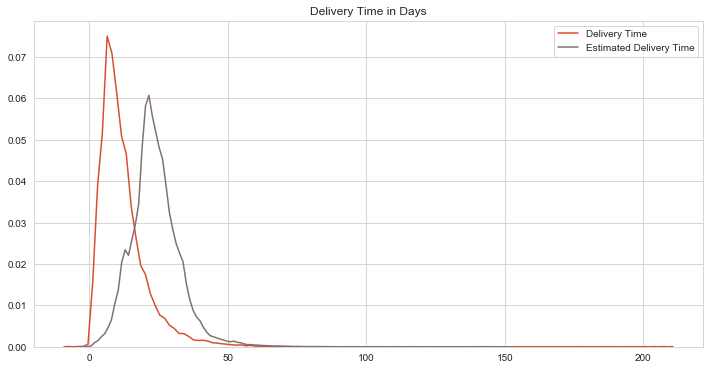

In [18]:
customer = customer.loc[customer['order_delivered_customer_date'].isnull() == False]
customer = customer.loc[customer['order_aproved_at'].isnull() == False]

customer['order_purchase_timestamp'] = pd.to_datetime(customer['order_purchase_timestamp'])
customer['order_aproved_at'] = pd.to_datetime(customer['order_aproved_at'])
customer['order_estimated_delivery_date'] = pd.to_datetime(customer['order_estimated_delivery_date'])
customer['order_delivered_customer_date'] = pd.to_datetime(customer['order_delivered_customer_date'])

customer['delivery_time'] = (customer['order_delivered_customer_date'] - customer['order_aproved_at']).dt.total_seconds() / 86400
customer['estimated_delivery_time'] = (customer['order_estimated_delivery_date'] - customer['order_aproved_at']).dt.total_seconds() / 86400

plt.figure(figsize = (12, 6))
sns.set_style('whitegrid')
plt.title("Delivery Time in Days")
ax1 = sns.kdeplot(customer['delivery_time'].dropna(),
                  color = "#D84E30",
                  label = "Delivery Time")
ax2 = sns.kdeplot(customer['estimated_delivery_time'].dropna(),
                  color = "#7E7270",
                  label = "Estimated Delivery Time")

we observe some outliers for the delivery time. In general, deliveries are often made before the estimated delivery time, which is good thing! 

#### Let's see how much the delivery time and review score are correlated.

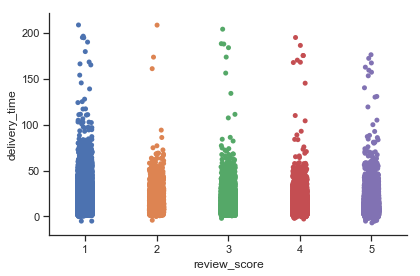

In [19]:
sns.set(style="ticks", color_codes=True)
ax = sns.catplot(x = "review_score",
                 y = "delivery_time",
                 data = customer,
                 height = 4,
                 aspect = 1.5)

Beside the extreme values, I don't see a strong tendency that higher review scores are associated with shorter delivery times.<br><br>
Let's see if delays are correlated with review_score.

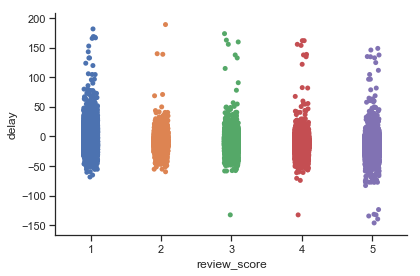

In [20]:
customer['delay'] = (customer['order_delivered_customer_date'] - customer['order_estimated_delivery_date']).dt.total_seconds() / 86400

ax = sns.catplot(x = "review_score",
                 y = 'delay',
                 data = customer,
                 height = 4,
                 aspect = 1.5)

Again I don't see a strong association between delays and review score. 

#### <br> We will look at the delivery time and delay distributions for each state.

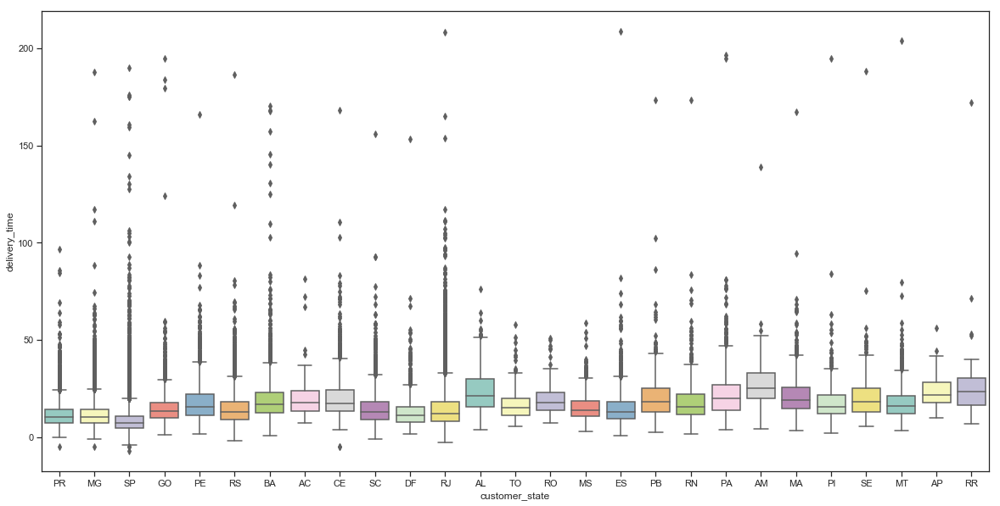

In [21]:
fig = plt.figure(figsize = (20, 10))
sns.boxplot(x = 'customer_state',
            y = 'delivery_time',
            data = customer,
            palette = "Set3")

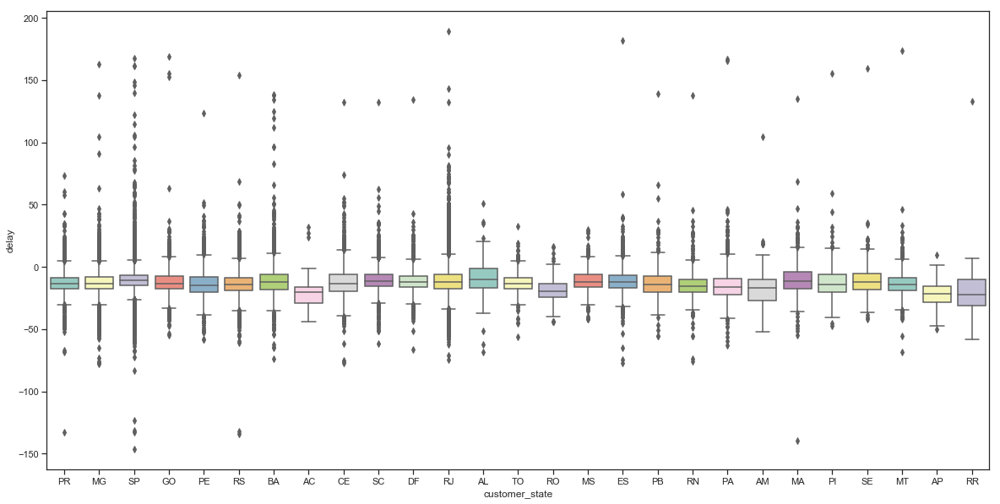

In [22]:
fig = plt.figure(figsize = (20, 10))
sns.boxplot(x = 'customer_state',
            y = 'delay',
            data = customer,
            palette = "Set3")

In [23]:
customer['datetime'] = pd.to_datetime(customer['order_purchase_timestamp'])
value_date = customer.groupby([customer['datetime'].dt.date])['order_products_value'].sum()
freight_date = customer.groupby([customer['datetime'].dt.date])['order_freight_value'].sum()

trace0 = go.Scatter(
    x = value_date.index.astype(str),
    y = value_date.values,
    opacity = 0.8,
    name = 'Product Value')
trace1 = go.Scatter(
    x = freight_date.index.astype(str),
    y = freight_date.values,
    opacity = 0.8,
    name = 'Freight Value')

layout = dict(
    title = "Product and Freight Value by Date",
    xaxis = dict(
        rangeselector = dict(
            buttons = list([
                dict(count = 1, label = '1m', step = "month", stepmode = 'backward'),
                dict(count = 6, label = "6m", step = "month", stepmode = "backward"),
                dict(count = 12, label = '12m', step = "month", stepmode = "backward"),
                dict(step = "all")
            ])),
        rangeslider = dict(visible = True),
        type = 'date'))

fig = dict(data = [trace0, trace1],
           layout = layout)
iplot(fig)

value_month = customer[['datetime', 'order_products_value']].copy()
value_month.set_index('datetime', inplace = True)
value_month = value_month.groupby(pd.Grouper(freq="M"))['order_products_value'].sum()
trace = go.Bar(x = value_month.index, y = value_month.values,
                  marker = dict(
                    color='rgba(55, 128, 191, 0.7)',
                    line=dict(
                    color='rgba(55, 128, 191, 1.0)',
                    width=1)))
layout = go.Layout(title = 'Sales per month (product value)', height = 420, width = 800)
fig = go.Figure(data = [trace], layout = layout)
iplot(fig)

Key Things:<br>
-  There is a peak on Nov 24th, 2017 due to Black Friday
-  There is a peak on July 18th, 2017 with 41.5K in product value. However, we don't see this trend on the same day in 2018.
-  Sales seem to be on decline for the latter half of 2018 compared to the same period in 2017

### Now we will look at the daily volumes of ordering and delivering using heatmap

We will first extract the attributes of weekday, hour, and total value

In [24]:
customer['total_value'] = customer['order_products_value'].add(customer['order_freight_value'])
pweekday = customer['order_purchase_timestamp'].dt.weekday
phour = customer['order_purchase_timestamp'].dt.hour
pprice = customer['total_value']
purchase = pd.DataFrame({'day of week': pweekday,
                         'hour': phour,
                         'price': pprice})
purchase['day of week'] = purchase['day of week'].map({0:'Mon', 1:'Tue', 2:'Wed', 3:'Thu', 4:'Fri', 5:'Sat',6:'Sun'})
purchase.head()

,day of week,hour,price
0,Tue,17,363.74
1,Sat,19,30.10
2,Mon,17,256.90
3,Sun,18,48.22
4,Thu,8,343.64


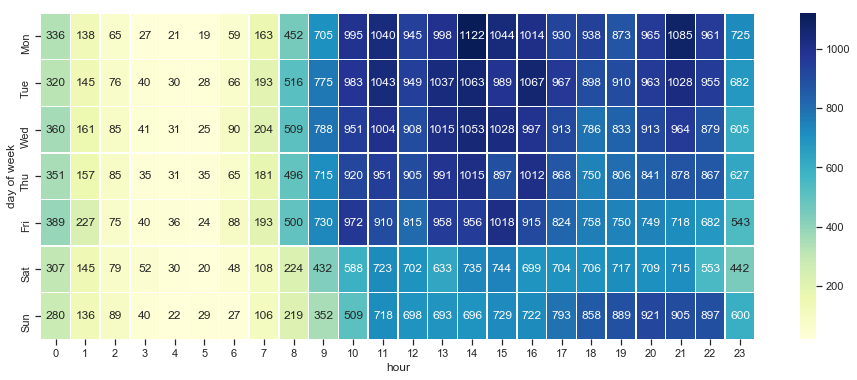

In [25]:
purchase_count = purchase.groupby(['day of week', 'hour']).count()['price'].unstack()
plt.figure(figsize = (16, 6))
sns.heatmap(purchase_count.reindex(index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']),
            cmap = "YlGnBu", annot = True, fmt = "d", linewidths = 0.5)

Not surprisingly, shopping volumes tend to slow down during weekends. During weekdays, customers tend to start shopping at around 8 A.M., and the shopping volume really picks up from 10 A.M. to 10 P.M. There are a good amount of shoppers around 11 P.M. and 12 A.M. as well.

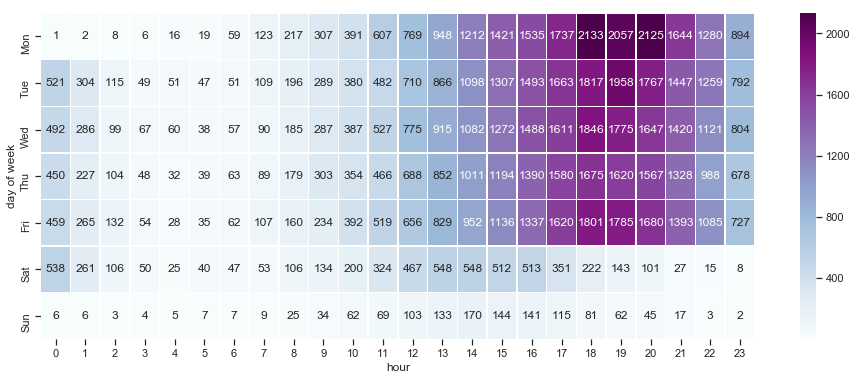

In [26]:
dweekday = customer['order_delivered_customer_date'].dt.weekday
dhour = customer['order_delivered_customer_date'].dt.hour
dprice = customer['total_value']
delivery = pd.DataFrame({'day of week': dweekday, 'hour': dhour, 'price': dprice})
delivery['day of week'] = delivery['day of week'].map({0:'Mon', 1:'Tue', 2:'Wed', 3:'Thu', 4:'Fri', 5:'Sat', 6:'Sun'})
delivery_count = delivery.groupby(['day of week', 'hour']).count()['price'].unstack()
plt.figure(figsize = (16, 6))
sns.heatmap(delivery_count.reindex(index = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']),
            cmap = 'BuPu', annot = True, fmt = "d", linewidths = 0.5)

The delivery heatmap is highly correlated with the ordering heatmap. During weekdays, delivery volumes start picking up from 2 P.M. and ending at 10 P.M. There aren't much delivery going on during weekends(obviously lol) 

#### Let's use a map to visualize the customer location and the the geographical difference for ordering and delivery values!

Let's look at how the customer locations spread out on map. The geo dataset has the latitude and longtitude values. 

In [27]:
data = [go.Scattermapbox(
    lon = geo['lng'],
    lat = geo['lat'],
    marker = dict(
        size = 5,
        color = 'green',
    ))]

layout = dict(
        title = 'Brazilian E-Commerce Geolocation',
        mapbox = dict(
            accesstoken = 'pk.eyJ1IjoicmljaGFyZGNoZTEiLCJhIjoiY2pudHdlYmVuMHlmMzNycW1vM2Jsb3Z1ZyJ9.U3AU-w0WgBf6Hcil8Q3e7w',
            center= dict(lat=-22,lon=-43),
            bearing=10,
            pitch=0,
            zoom=2,
        )
    )
fig = dict( data=data, layout=layout )
iplot( fig, validate=False)

It looks like a majority of the customer reside on the east coast of Brazil.

In order to visualize ordering and delivery value on a map, we will have to merge all 3 tables together. 

In [28]:
customer = pd.merge(customer,
                 payment[['order_id', 'installments', 'sequential', 'payment_type', 'value']],
                 on='order_id')
customer.head()

,order_id,order_status,order_products_value,order_freight_value,order_items_qty,order_sellers_qty,order_purchase_timestamp,order_aproved_at,order_estimated_delivery_date,order_delivered_customer_date,...,review_answer_timestamp,delivery_time,estimated_delivery_time,delay,datetime,total_value,installments,sequential,payment_type,value
0,b95df3cef5297e79ef709ba256518f6f,delivered,349.90,13.84,1,1,2017-01-31 17:19:01,2017-02-01 02:41:21.549551,2017-03-15,2017-02-06 11:04:24.154259,...,2017-02-09 02:37:37+00:00,5.349336,41.887945,-36.538609,2017-01-31 17:19:01,363.74,1,1,boleto,363.74
1,59af46052a799e80e2f0c665c587731d,delivered,15.00,15.10,1,1,2017-09-09 19:52:54,2017-09-10 20:03:31.535281,2017-10-02,2017-09-13 20:17:41.296915,...,2017-09-15 03:43:47+00:00,3.009835,21.164218,-18.154383,2017-09-09 19:52:54,30.10,1,1,credit_card,30.10
2,a3e6136894621db402a772c6bc72a12a,delivered,238.90,18.00,1,1,2017-01-30 17:00:09,2017-01-30 17:31:25.438253,2017-03-07,2017-02-06 15:43:04.758566,...,2017-02-10 14:18:53+00:00,6.924761,35.269844,-28.345084,2017-01-30 17:00:09,256.90,10,1,credit_card,256.90
3,b675ea5a618922f6e679e30531b8957b,delivered,29.99,18.23,1,1,2018-03-11 18:18:36,2018-03-11 18:30:37.931962,2018-04-03,2018-04-03 20:36:43.778451,...,2018-04-05 02:52:31+00:00,23.087568,22.228728,0.858840,2018-03-11 18:18:36,48.22,4,1,credit_card,48.22
4,195a8be6794c487fe6cfbb97b7c61902,delivered,295.99,47.65,1,1,2017-04-20 08:01:08,2017-04-25 08:05:40.405383,2017-05-24,2017-05-04 18:47:45.721758,...,2017-05-08 15:20:18+00:00,9.445895,28.662727,-19.216832,2017-04-20 08:01:08,343.64,1,1,boleto,343.64


In [29]:
customer['customer_state'] = customer['customer_state'].apply(lambda x : x.lower())
customer['customer_city'] = customer['customer_city'].apply(lambda x : x.lower())
geo_state = geo.groupby('state')['lat','lng'].mean().reset_index()
geo_state['state'] = geo_state['state'].apply(lambda x : x.lower())
geo_city = geo.groupby('city')['lat','lng'].mean().reset_index()
geo_city['city'] = geo_city['city'].apply(lambda x : x.lower())
geo_city.rename(columns={'lat': 'c_lat','lng':'c_lng'}, inplace=True)

customer = pd.merge(customer, geo_state, how='left', left_on='customer_state',right_on='state')
customer = pd.merge(customer, geo_city, how='left', left_on='customer_city', right_on='city')

customer.head()

,order_id,order_status,order_products_value,order_freight_value,order_items_qty,order_sellers_qty,order_purchase_timestamp,order_aproved_at,order_estimated_delivery_date,order_delivered_customer_date,...,installments,sequential,payment_type,value,state,lat,lng,city,c_lat,c_lng
0,b95df3cef5297e79ef709ba256518f6f,delivered,349.90,13.84,1,1,2017-01-31 17:19:01,2017-02-01 02:41:21.549551,2017-03-15,2017-02-06 11:04:24.154259,...,1,1,boleto,363.74,pr,-24.859733,-50.555558,guaratuba,-25.887676,-48.581845
1,59af46052a799e80e2f0c665c587731d,delivered,15.00,15.10,1,1,2017-09-09 19:52:54,2017-09-10 20:03:31.535281,2017-10-02,2017-09-13 20:17:41.296915,...,1,1,credit_card,30.10,mg,-19.793424,-44.319194,uberlandia,-18.917586,-48.276306
2,a3e6136894621db402a772c6bc72a12a,delivered,238.90,18.00,1,1,2017-01-30 17:00:09,2017-01-30 17:31:25.438253,2017-03-07,2017-02-06 15:43:04.758566,...,10,1,credit_card,256.90,sp,-22.912643,-47.519591,itapevi,-23.547372,-46.941524
3,b675ea5a618922f6e679e30531b8957b,delivered,29.99,18.23,1,1,2018-03-11 18:18:36,2018-03-11 18:30:37.931962,2018-04-03,2018-04-03 20:36:43.778451,...,4,1,credit_card,48.22,go,-16.521070,-49.249792,goiania,-16.681258,-49.275942
4,195a8be6794c487fe6cfbb97b7c61902,delivered,295.99,47.65,1,1,2017-04-20 08:01:08,2017-04-25 08:05:40.405383,2017-05-24,2017-05-04 18:47:45.721758,...,1,1,boleto,343.64,pe,-8.188236,-35.817496,recife,-8.070574,-34.915309


In [30]:
city_spend = customer.groupby(['customer_city', 'c_lng', 'c_lat'])['order_products_value'].sum().to_frame().reset_index()
city_freight = customer.groupby(['customer_city', 'c_lng', 'c_lat'])['order_freight_value'].mean().reset_index()
state_spend = customer.groupby(['customer_state', 'lng', 'lat'])['order_products_value'].sum().to_frame().reset_index()
state_freight = customer.groupby(['customer_state', 'lng', 'lat'])['order_freight_value'].sum().to_frame().reset_index()
state_freight['text'] = 'state :' + state_freight['customer_state'] + ' | Freight: ' + state_freight['order_freight_value'].astype(str)
state_freight.head()

,customer_state,lng,lat,order_freight_value,text
0,ac,-68.882327,-9.486186,3675.37,state :ac | Freight: 3675.369999999998
1,al,-36.303257,-9.599067,15510.33,state :al | Freight: 15510.329999999984
2,am,-61.083354,-3.613886,5004.02,state :am | Freight: 5004.019999999999
3,ap,-51.171173,0.075472,2558.79,state :ap | Freight: 2558.79
4,ba,-39.694896,-12.909415,97191.66,state :ba | Freight: 97191.65999999935


In [31]:
data = [go.Scattergeo(
    lon = state_spend['lng'],
    lat = state_spend['lat'],
    text = state_freight['text'],
    marker = dict(
        size = state_spend['order_products_value'] / 3000,
        sizemin = 5,
        color = state_freight['order_freight_value'],
        colorscale = 'Reds',
        cmin = 20,
        cmax = 50,
        line = dict(width = 0.1, color = 'rgb(40, 40, 40)'),
        sizemode = 'area'
    ),
    name = 'State'),
    go.Scattergeo(
    lon = city_spend['c_lng'],
    lat = city_spend['c_lat'],
    text = city_freight['order_freight_value'],
    marker = dict(
        size = city_spend['order_products_value'] / 1000,
        sizemin = 2,
        color = city_freight['order_freight_value'],
        colorscale = 'Blues',
        reversescale = True,
        cmin = 0,
        cmax = 80,
        line = dict(width = 0.1, color = 'rgb(40, 40, 40)'),
        sizemode = 'area'),
    name = 'City')
       ]

layout = dict(
        title = 'Brazilian E-commerce Order and Freight Values (Click legend to toggle traces)',
        showlegend = True,
        autosize = True,
        width = 900,
        height = 600,
        geo = dict(
            scope = "south america",
            projection = dict(type = 'winkel tripel', scale = 1.6),
            center = dict(lon = -47, lat = -22),
            showland = True,
            showcountries = True,
            showsubunits = True,
            landcolor = 'rgb(155, 155, 155)',
            subunitwidth = 1,
            countrywidth = 1,
            subunitcolor = 'rgb(255, 255, 255)',
            countrycolor = 'rgb(255, 255, 255)'))

fig = dict(data = data, layout = layout)
iplot(fig, validate = False)

The dots or the circles represent the ordering values and color represents the freight values. The deeper the color the higher the freight values. We can observe that customers who reside on the east coast of Brazil tend to pay more for delivery. Additionally, a majority of the tranactions associated with lower cost of delivery concentrate in the south of Brazil.

### I will conclude my project here. I really learned the essence of data visualization doing this project. Communicating insights with visually stunning graphs and charts often makes you presentation 10x better. I hope you learned something new here and I encourage you to pick up the dataset and try these beautiful data visualizations on your own. Thank you!